In [2]:
using Pkg
Pkg.activate("../IVTmodel")
Pkg.instantiate()
include("../modules/IVTmodel.jl")
#Generates settings for parameters used
fittingmodel = setupmodel_IVT4()
#Imports calibration data from csv files
modeldata = importakamadata()
osumidata = importosumidata()
#Imports PPiase validation data
PPiasedata = importakamaPPiasedata();
akamafittedparametersmatrix = Matrix(CSV.read("../outputs/fittedparameters.csv", DataFrame,header=false))
akamafittedparameterslist = reshape(akamafittedparametersmatrix,(size(akamafittedparametersmatrix)[1],))
akamafittedcovariancematrix = Matrix(CSV.read("../outputs/covariancematrix.csv", DataFrame,header=false))
akamafittedparams = fullparameterset(fittingmodel,akamafittedparameterslist)
printresidual(fittingmodel,modeldata,osumidata,akamafittedparameterslist)

  Activating project at `C:\Users\ChemeGrad2021\Documents\Braatz Group\MRNA Synthesis\Published code\IVT2.0\IVTmodel`
Precompiling project...
  ? Metrics
Precompiling Metrics
        Info Given Metrics was explicitly requested, output will be shown live 
ERROR: Method overwriting is not permitted during Module precompilation. Use `__precompile__(false)` to opt-out of precompilation.
  ? Metrics
[ Info: Precompiling Metrics [cb9f3049-315b-4f05-b90c-a8adaec4da78]
ERROR: Method overwriting is not permitted during Module precompilation. Use `__precompile__(false)` to opt-out of precompilation.
[ Info: Skipping precompilation since __precompile__(false). Importing Metrics [cb9f3049-315b-4f05-b90c-a8adaec4da78].
┌ Warning: Replacing docs for `Metrics.bin_to_cat :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243
┌ Warning: Replacing docs for `Metrics.confusion_matrix :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243
┌ Warning: Replacing docs for `Metri

Model has 20 fitted parameters, 12 of which have a bayesian prior


┌ Warning: Replacing docs for `Metrics.global_stats :: Tuple{Any, Any}` in module `Metrics`
└ @ Base.Docs docs\Docs.jl:243


Total Residual:                        1031.5
Components of residual:
Concentration Trajectories (Figure 2): 388.4
Initial Reaction Rate (Figure 3A):     146.0
Mg2PPi solubility (Figure 3B):         218.6
Parameter priors:                      196.7
pH Effect Data:                        81.8


In [3]:
using StatsPlots
using Turing

In [13]:
function competitiveT7bindingmodel(Mg,salt,T7,param; s0 = 14e-3, s_background = 0)#Total cations in M
    Cl = salt+s_background
    #MgT7 = T7*Mg/(param.K_Mg+Mg)
    #Kf = param.Kf0*totalcations^(-param.Nf)
    #Ku = param.Ku0*totalcations^(-param.Nu)
    #Kf = exp(param.logKf0 - param.Nf*(log(salt)-log(s0)))
    #Ku = exp(param.logKu0 - param.Nu*(log(salt)-log(s0)))
    Kf = exp(param.logKf0)
    Ku = exp(param.logKu0)
    K_Mg = exp(param.K_Mg)
    return 400e-9*Kf/((1+(Cl*Ku)^param.Nu)*(1+(Mg*K_Mg)^param.Nf))
end

function T7bindingresidual(bindingdata, param; T7 = 80e-9, error = 0.3)
    sum = 0
    for (MgCl2, NaCl, bindingratio) in eachrow(bindingdata)
        sum+=(bindingratio - competitiveT7bindingmodel(MgCl2/1000,(3*MgCl2+2*NaCl)/1000,T7,param))^2/(error)^2
    end
    return sum
end

function plotT7binding!(plt,bindingdata, param; showpredictions = true, Namodelrange = (0,200), npredict = 1000, T7 = 80e-9, ylim = (0,4), colorscheme = :berlin, error = 0.3, linewidth = 2, plotdata = true, plotpred = true)
    plot!(plt, xlabel = "NaCl (mM)", ylabel = "Ratio of Bound to Unbound DNA Promoters", ylim = ylim, size = (800,500))
    Mgs = unique(bindingdata[:,1])
    Na = bindingdata[1:4,2]
    for (Mgind,Mg) in enumerate(Mgs)
        color = palette(colorscheme,length(Mgs))[Mgind]
        if showpredictions
            Na_predictions = LinRange(Namodelrange[1],Namodelrange[2],npredict)
            predictedbinding = zeros(npredict)
            for (ind,Na) in enumerate(Na_predictions)
                predictedbinding[ind] = competitiveT7bindingmodel(Mg/1000,(2*Mg+Na)/1000,T7,param)
            end
            if plotpred
                plot!(Na_predictions,predictedbinding, color =color, linewidth = linewidth, label = "")
            end
        end
        if plotdata
            validbinding = bindingdata[bindingdata[:,1] .== Mg,3]
            scatter!(Na,validbinding, color =color, label = "Mg = "*string(Mg)*" mM", yerror = error)
        end
    end
    return plt
end


plotT7binding! (generic function with 1 method)

In [5]:
T7bindingfilename = "../data/external/gunderson/gundersonbinding.csv"
bindingdatadf = CSV.read(T7bindingfilename,DataFrame)
bindingdata = Matrix(bindingdatadf)
testbindingdata = bindingdata[5:end,:]
testbindinginputs = testbindingdata[:,1:2]
testbindingoutputs = testbindingdata[:,3];

┌ Info: Found initial step size
└   ϵ = 3.225
┌ Info: Found initial step size
└   ϵ = 0.8
┌ Info: Found initial step size
└   ϵ = 0.2


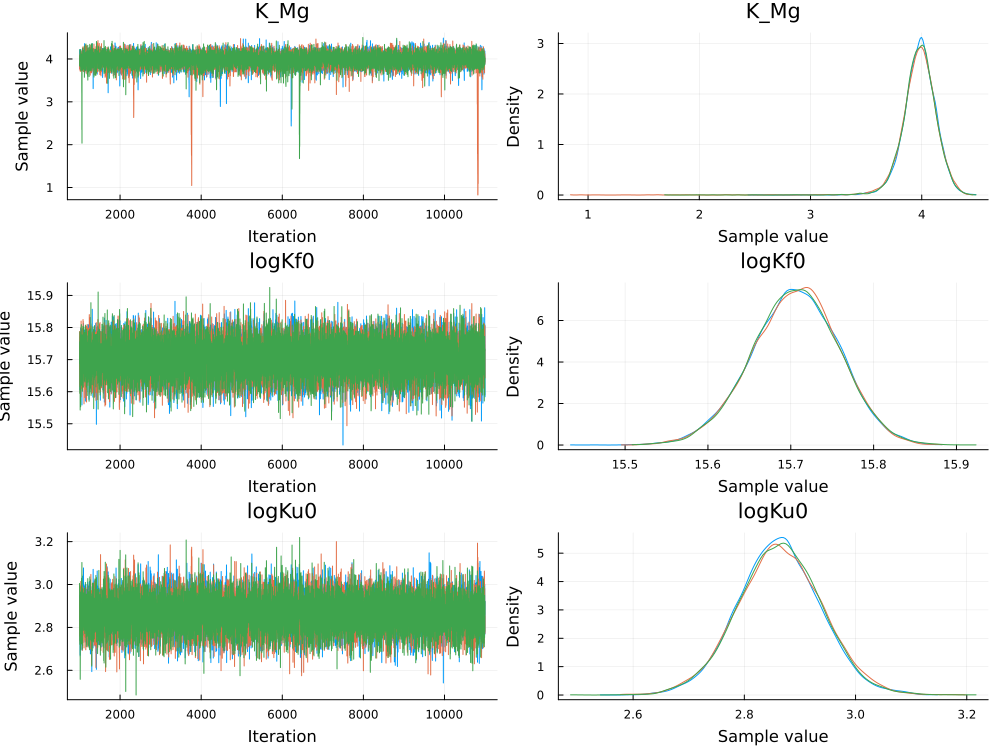

In [6]:
@model function T7bindingmodel(bindinginputs, measuredbindingratios, ::Type{T} = Float64; 
        T7 = 80e-9,
        σ = missing,
        Nf = missing,
        Nu = missing,
        K_Mg = missing,
        logKf0 = missing,
        logKu0 = missing,
        σdist = InverseGamma(3,0.5), 
        Nfdist = Uniform(0,10), 
        Nudist = Uniform(0,10), 
        K_Mgdist = Uniform(0.01,10), 
        logKf0dist = Uniform(10,20),
        logKu0dist = Uniform(0.1,10)) where {T}
    
    if measuredbindingratios === missing
        # Initialize `x` if missing
        measuredbindingratios = Vector{T}(undef, 1)
    end
    
    if σ === missing
        σ ~ σdist
    end
    
    if Nf === missing
        Nf ~ Nfdist
    end
    
    if Nu === missing
        Nu ~ Nudist
    end
    
    if K_Mg === missing
        K_Mg ~ K_Mgdist
    end
    
    if logKf0 === missing
        logKf0 ~ logKf0dist 
    end
    
    if logKu0 === missing
        logKu0 ~ logKu0dist
    end
    
    
    # Simulate T7 Binding. 
    p = ComponentArray(Nf = Nf, Nu = Nu, K_Mg = K_Mg, logKf0 = logKf0, logKu0 = logKu0)
    predicted = [competitiveT7bindingmodel(MgCl2/1000,(2*MgCl2+1*NaCl)/1000,T7,p) for (MgCl2, NaCl) in eachrow(bindinginputs)]
    
    for i in 1:length(predicted)
        measuredbindingratios[i] ~ Normal(predicted[i], σ)
    end
end

# Construct a model with x = missing
model = T7bindingmodel(testbindinginputs,testbindingoutputs, Nf = 4, Nu = 4, σ = 0.3)
c = sample(model, NUTS(), MCMCSerial(), 10000, 3; progress=false)
plot(c)

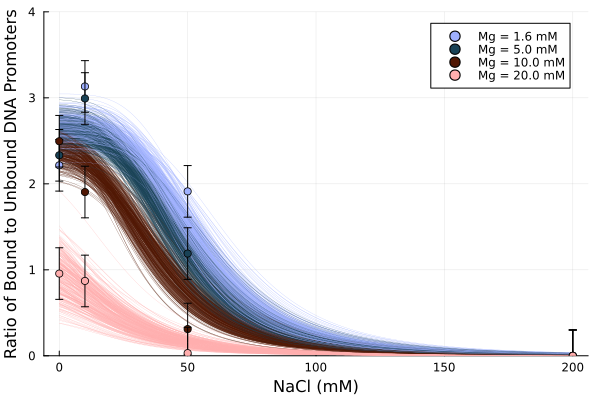

In [15]:
plt = plot()
nsamples = 300
posterior_samples = sample(c, nsamples; replace=false)
for (ind,(K_Mg, logKf0, logKu0)) in enumerate(eachrow(Array(posterior_samples)))
    testparam = ComponentArray(Nf = 4, Nu = 4, K_Mg = K_Mg, logKf0 = logKf0, logKu0 = logKu0)
        plotT7binding!(plt,testbindingdata, testparam; linewidth = 0.2, plotdata = ind == nsamples, plotpred = true)
end
plot!(size = (600,400))
#plot!(dpi = 400)
savefig(plt,"../figures/GM6_27/magnus2.png")
plt

78.85263395739868


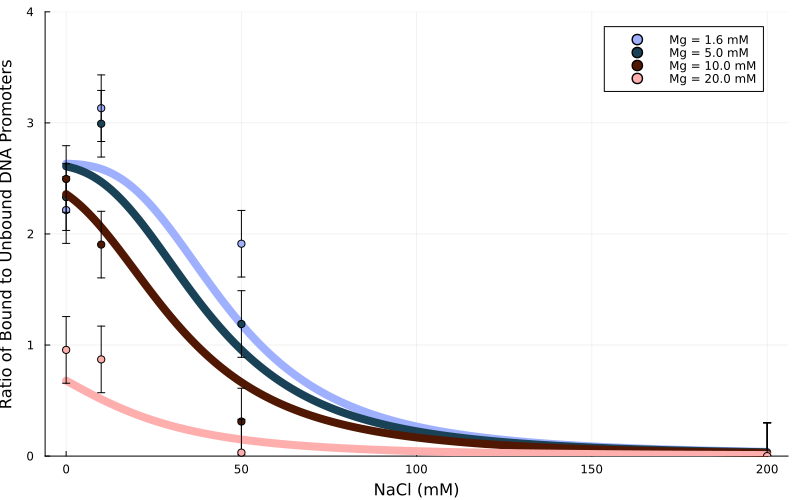

In [8]:
plt = plot()
testparam = ComponentArray(Nu = 3, Nf = 5, K_Mg = 4,logKf0 = 15.7, logKu0 = 3)
func = x -> T7bindingresidual(testbindingdata, x)
println(func(testparam))
plotT7binding!(plt,testbindingdata, testparam; linewidth = 8)